In [1]:
from wiggle import writhe as wr
from wiggle import CarbonaraDataTools as cdt

from scipy import interpolate
import numpy as np

import seaborn as sns
from matplotlib.colors import LogNorm, Normalize
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl

import plotly.graph_objects as go

mpl.rcParams['figure.dpi'] = 300

### Lets import a knotted protein curve, create a smooth version of it and visualise them

In [2]:
coords = cdt.extract_coords_from_PDB('6zr9_A_Knot3_1.pdb')

In [4]:
# see original protein
fig = cdt.line_plotly(coords[:,0], coords[:,1], coords[:,2], color_lst=coords.shape[0]*['blue'], outline=True)
fig.update_layout(height = 800, width=800)

In [5]:
tck, u = interpolate.splprep([coords[:,0], coords[:,1], coords[:,2]], s=.05)
oversample = 4
res_size = oversample*coords.shape[0]
u_fine = np.linspace(0,1,res_size)
x,y,z = interpolate.splev(u_fine, tck)

In [6]:
fig = cdt.line_plotly(x,y,z, color_lst=len(x)*['blue'], outline=True)
fig.update_layout(height = 800, width=800)

### Taking smoothed oversampled protein curve and calculating the pairwise writhe

In [7]:
smooth_coords = np.vstack([x,y,z,]).T

In [8]:
S = wr.find_Sigma_array(smooth_coords)
S[np.triu_indices(S.shape[0], -1)] = np.nan

<Axes: >

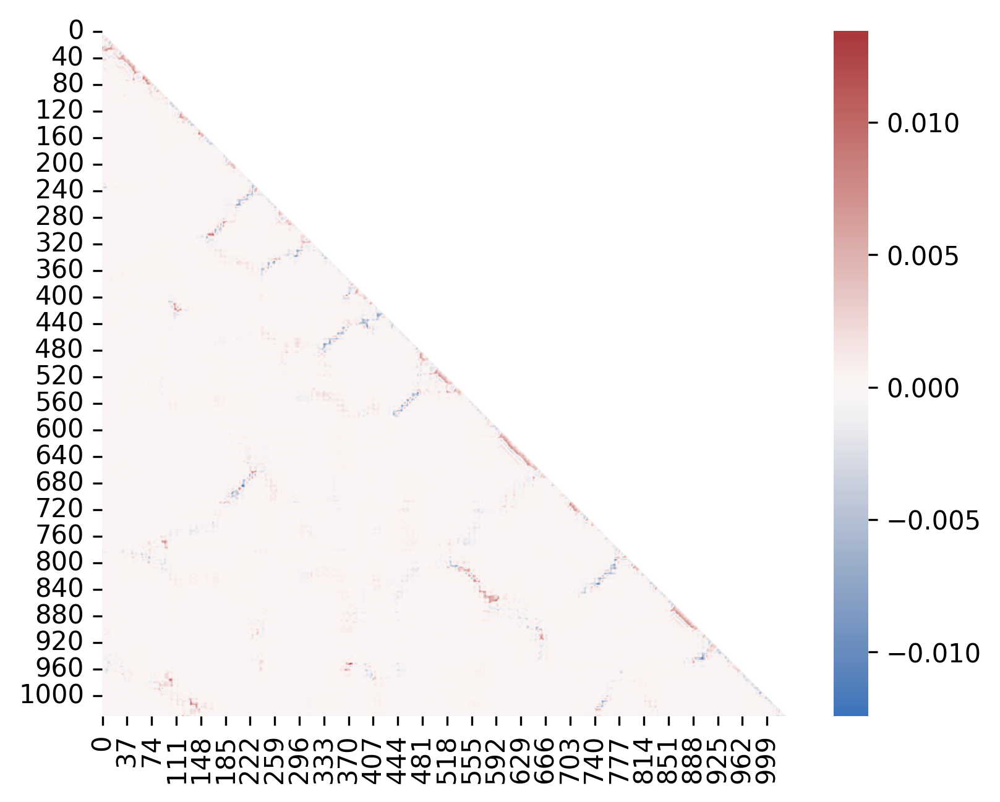

In [9]:
mask = np.zeros_like(S)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(S, mask=mask, square=True, cmap="vlag", center=0)
# sns.heatmap(S, mask=mask, square=True, cmap="vlag", center=0, norm=LogNorm())

Cant see much of anything here :(

Lets have a look at the distribution of pairwise writhes in smoothed interpolated curve

[Text(0.5, 1.0, 'Distribution of segment pair writhes for smoothed curve (4x res in interpolation)'),
 Text(0.5, 0, 'Writhe Val')]

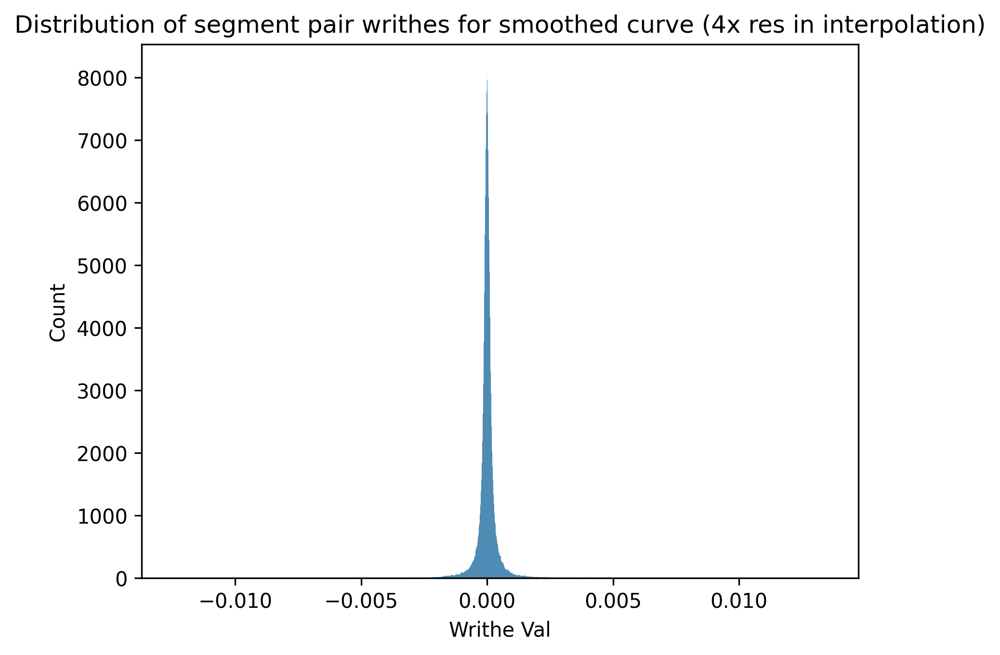

In [10]:
x = np.ravel(S)
sns.histplot(x).set(
    title='Distribution of segment pair writhes for smoothed curve (4x res in interpolation)',
    xlabel='Writhe Val')

Thats a super narrow dist - almost everything is in a small region around zero, 1 or 2 orders of magnitude less than the extremes.

This is whats messing up the visualisation - in comparison everything looks like zero!

In [11]:
def give_me_writhe(XYZ):

    '''
    Take XYZ coordinates and calculate the pairwise writhe, assign NaN to upper triangular

    input
    XYZ (Nx3 numpy.array): XYZ coordinates of curve

    output
    S (numpy.array): Pairwise writhe metric
    x (numpy.array): unravelled, NaN cleaned values of S
    '''
    
    S = wr.find_Sigma_array(XYZ)
    S[np.triu_indices(S.shape[0], -1)] = np.nan
    
    x = np.ravel(S)
    x = x[~np.isnan(x)]

    return S, x

In [12]:
def explore_pairwise_writhe(S, x):

    '''
    Plot 2x2 subplot of heatmaps with various cutoff limits in order to make visualisation of 
    smaller values more clear. Cutoffs: none, max_val/5, max_val/10 and max_val/20

    inputs
    S (numpy.array): Pairwise writhe metric
    x (numpy.array): unravelled, NaN cleaned values of S

    output
    None
    '''
    
    max_S = np.max(np.abs(x))
    
    plt.figure(figsize=(16, 13.))
    coff_lst = [1,5,10,20]
    for i in range(4):
        
        plt.subplot(2, 2, i+1)
        plt.imshow(S, cmap='RdBu')
    
        coff = max_S/coff_lst[i]
        
        if i==0:
            plt.colorbar()
            plt.gca().set_title('No cutoff')
    
        else:
            plt.colorbar(extend='both')
            plt.clim(-coff, coff);
            plt.gca().set_title('cutoff: '+str(coff))

    plt.show()

#### Lets explore the oversampled protein

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: 1 *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*


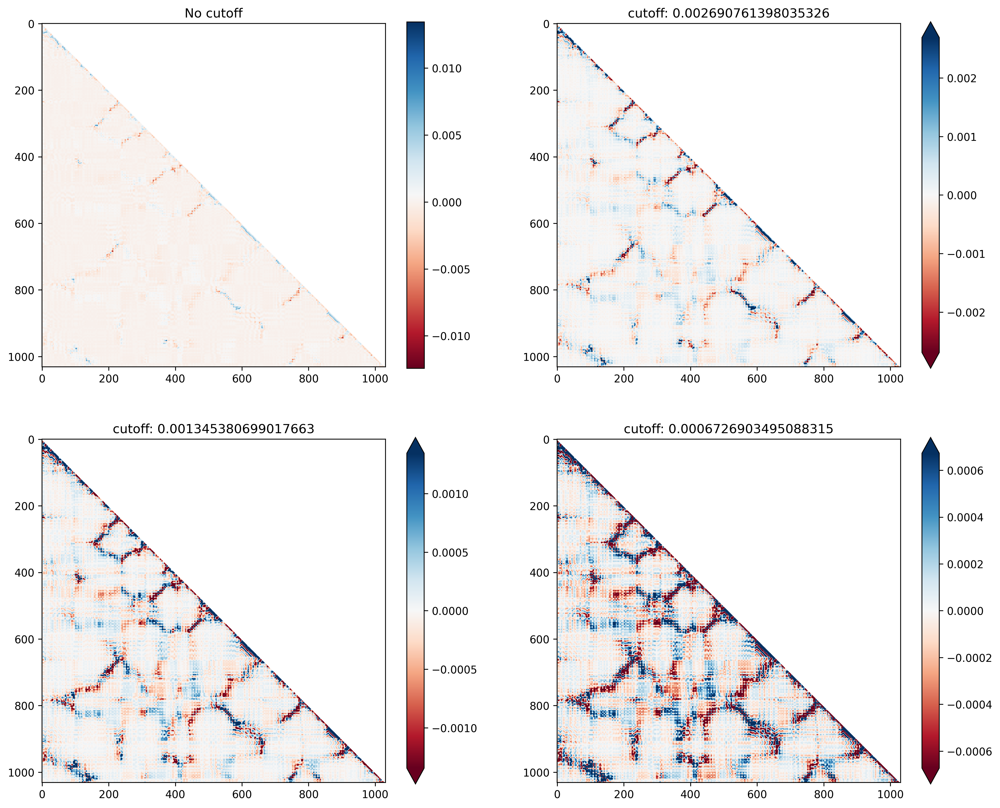


*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: 2 *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*


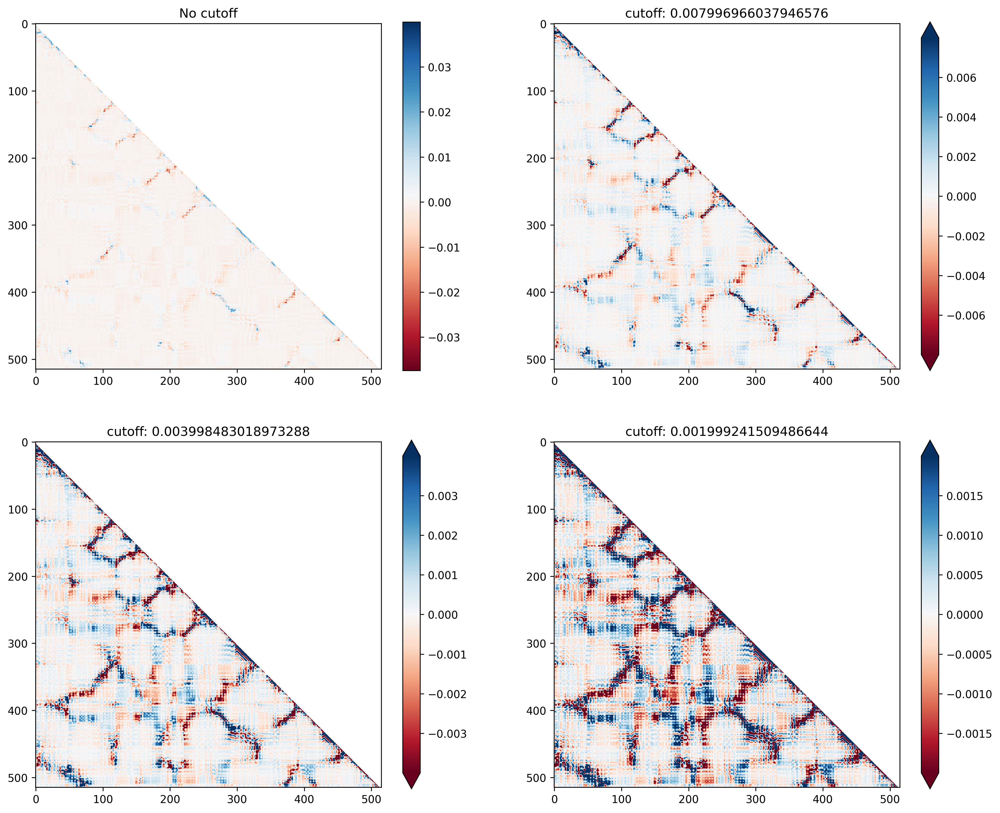


*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: 4 *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*


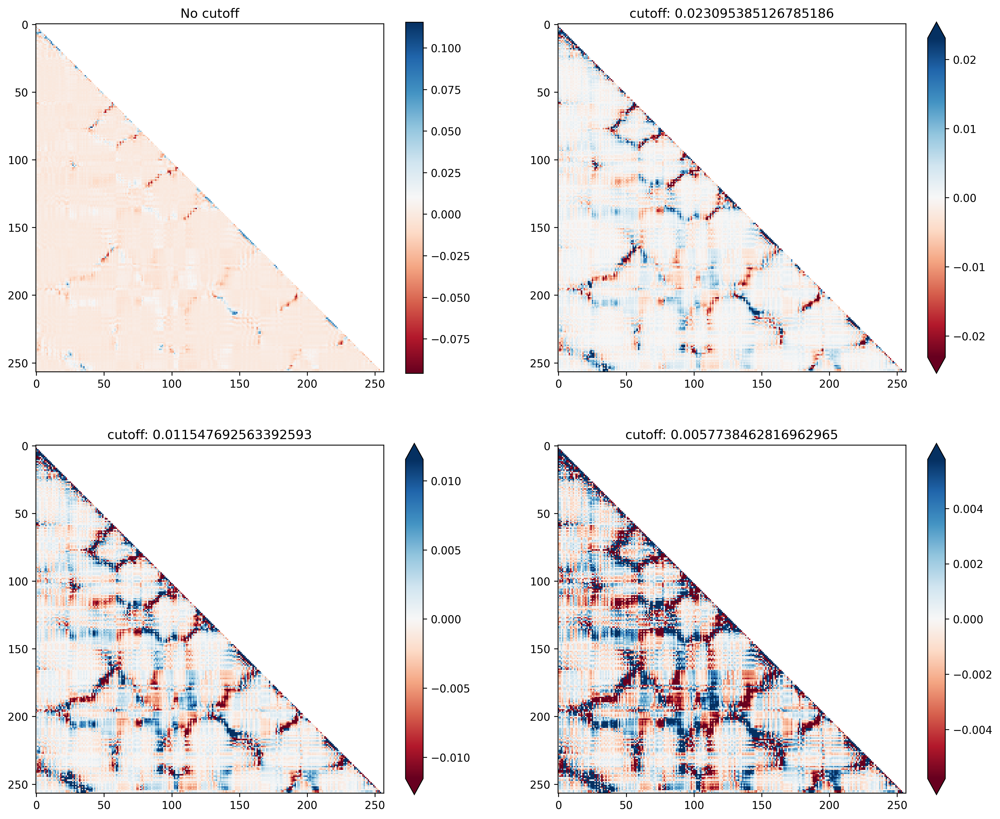


*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: 8 *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*


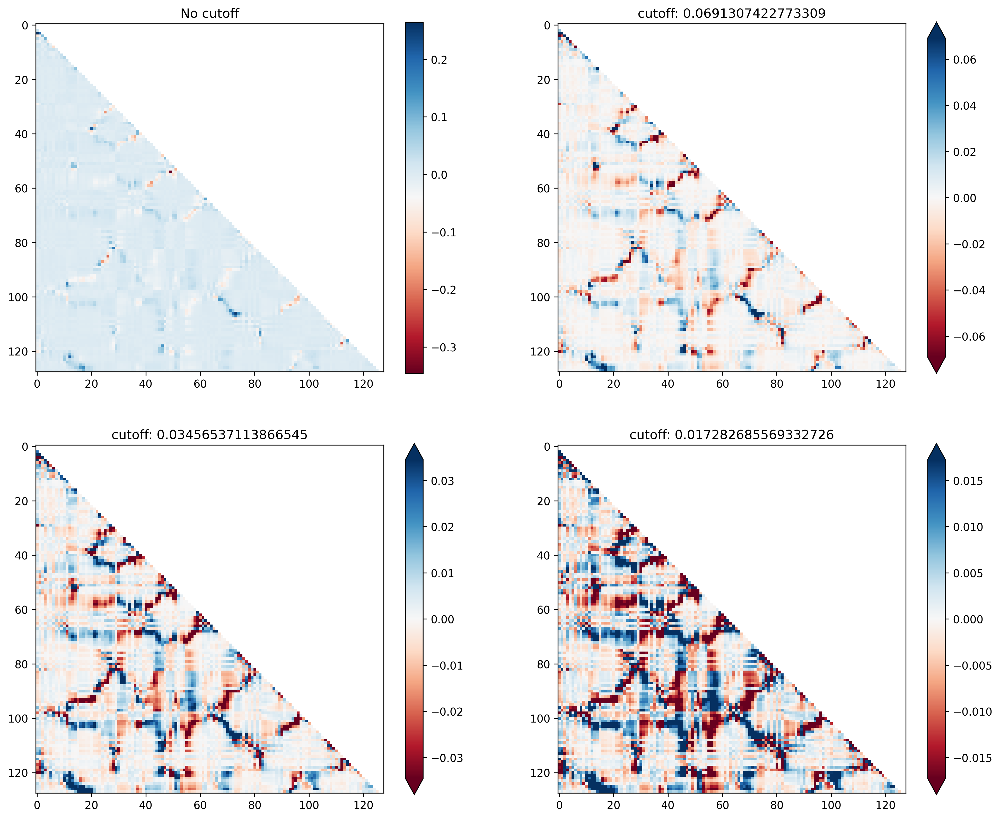


*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: 16 *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*


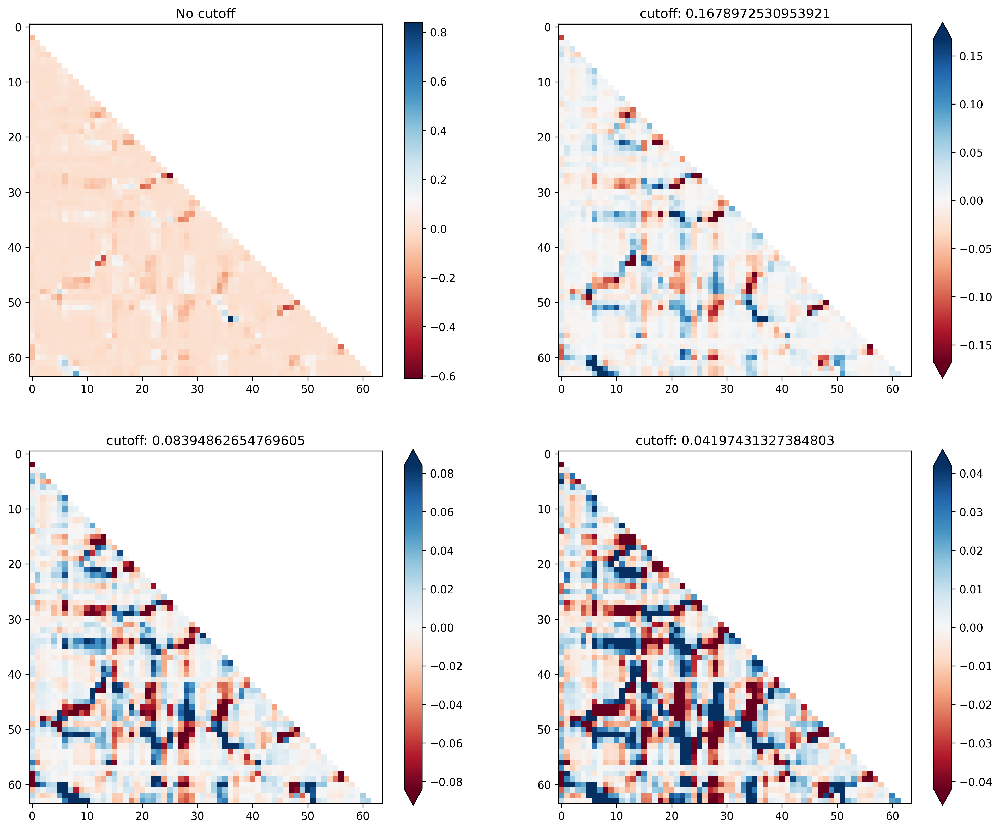

In [38]:
writhe_dict = {}

step_lst = [1,2,4,8,16]
for step in step_lst:

    writhe_dict[step] = give_me_writhe(smooth_coords[::step,:])

    print('*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: ' + str(step) + ' *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*')
    explore_pairwise_writhe(writhe_dict[step][0], writhe_dict[step][1])
    print('')

Better but still not super clear - cutoff means have light + dark splotches where we cant see detail

Again look at distributions of writhe pair values - notice they increase with larger segments which makes sense from equations

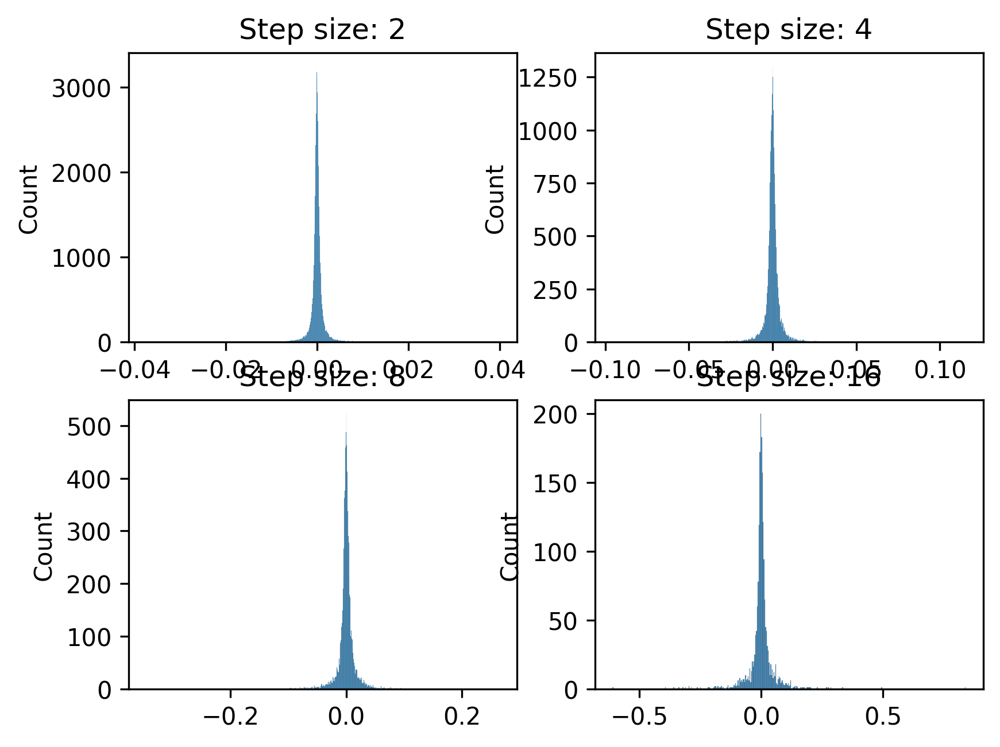

In [14]:
for i, step in enumerate(step_lst[1:]):

    plt.subplot(2, 2, i+1)
    
    sns.histplot(writhe_dict[step][1], )
    plt.gca().set_title('Step size: ' + str(step))
    

### Trying to make a custom (continuous) color bar whose changing blue -> red is a function of the cumulative distribution of data

In other words: I want to see shit in that thin middle region, but also have some appreciation for the really big / small stuff

<Axes: ylabel='Proportion'>

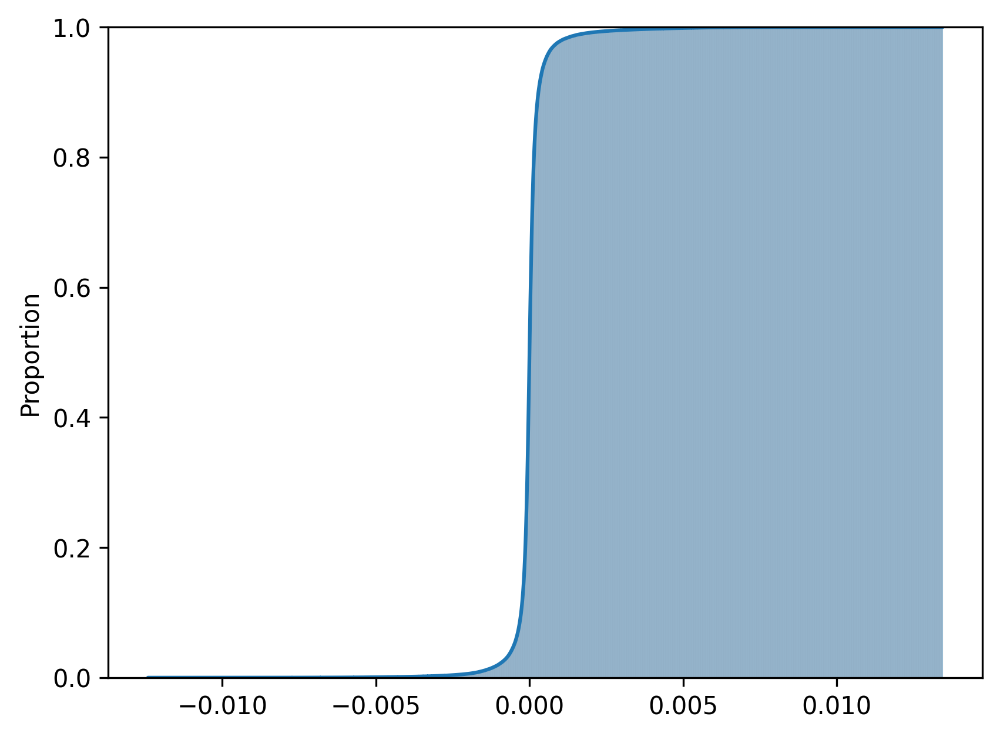

In [15]:
stat = "proportion"  # or proportion
sns.histplot(x, stat=stat, cumulative=True, alpha=.4)
sns.ecdfplot(x, stat=stat)

In [16]:
sorted_x = np.sort(x[~np.isnan(x)])
    
# index of 10%, 20%, ... 90% point in sorted x values

deci_indices = np.floor(np.arange(1,256)*sorted_x.shape[0]/256)

# sorted_x[deci_indices.astype(int)] - sorted_x[deci_indices.astype(int)][49]

In [17]:
def heatmap_non_linear_color(S, x):

    sorted_x = np.sort(x[~np.isnan(x)])
    
    # index of 1%, 2%, ... 99% point in sorted x values
    deci_indices = np.floor(np.arange(1,100)*sorted_x.shape[0]/100)
    deci_vals = sorted_x[deci_indices.astype(int)]
    
    # Whatever happens, jappens - no monkey business moving middles values around
    # bounds = deci_vals

    # Shift entire s-curve so middle value is zero - not sure if this is okay to do, but I'm god here so what I say goes!
    bounds = deci_vals - deci_vals[49]

    # Just a cheeky check that we havent fucked the top / bottom end - as we append the first + last val of x as the bin edges
    assert sorted_x[-1] - sorted_x[-2] > deci_vals[49], 'Shift to renormalise color scale larger than diff between last 2 vals'
    assert sorted_x[1] - sorted_x[0] > deci_vals[49], 'Shift to renormalise color scale larger than diff between first 2 vals'
    
    bounds = np.append(sorted_x[0], bounds)
    bounds = np.append(bounds, sorted_x[-1])
    
    fig, ax = plt.subplots(1, 1, figsize=(8, 6), layout='constrained')
    
    norm = colors.BoundaryNorm(boundaries=bounds, ncolors=256)
    pcm = ax.imshow(S, norm=norm, cmap='RdBu_r')
    fig.colorbar(pcm, ax=ax, extend='both', orientation='vertical')
    ax.set_title('Colour Scale: Distribution')

    plt.show()

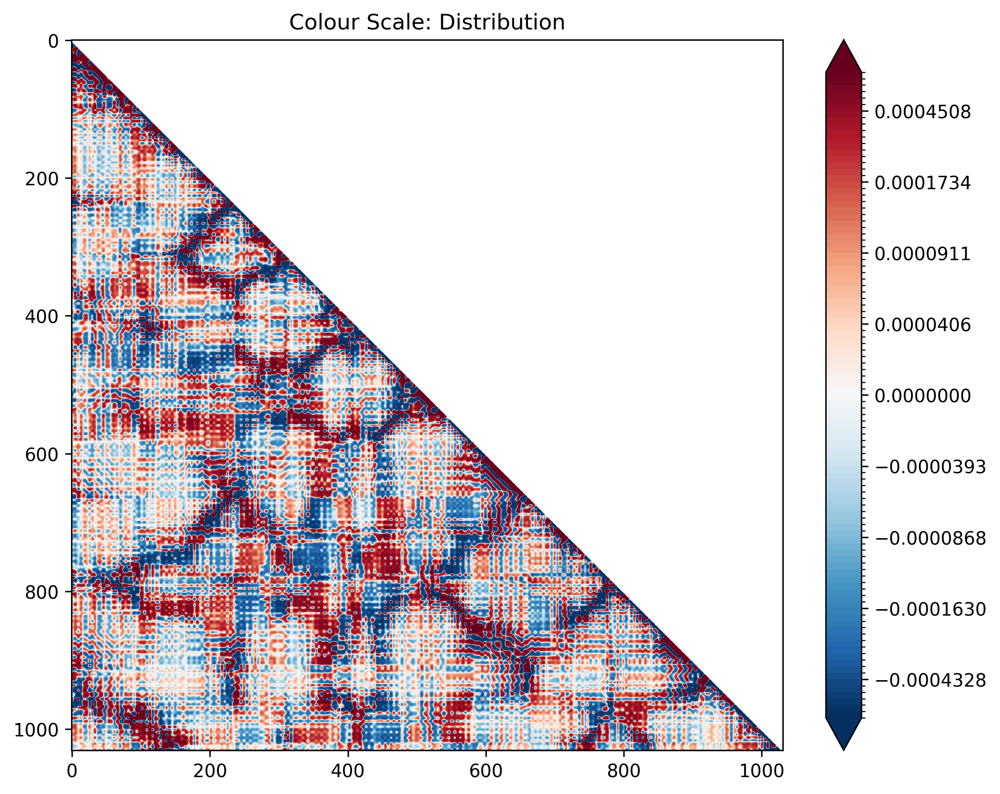

In [18]:
# full oversampled resolution - not sure we should continue with this as not real points
step = 1
heatmap_non_linear_color(S=writhe_dict[step][0], x=writhe_dict[step][1])

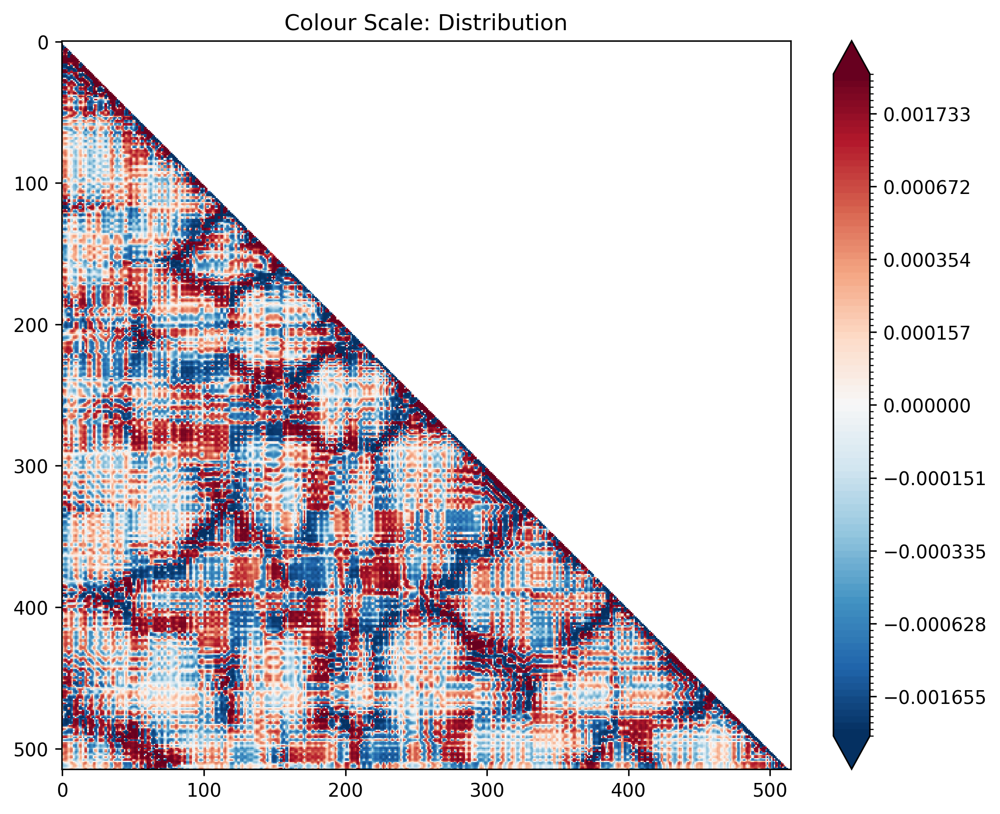

In [19]:
step = 2
heatmap_non_linear_color(S=writhe_dict[step][0], x=writhe_dict[step][1])

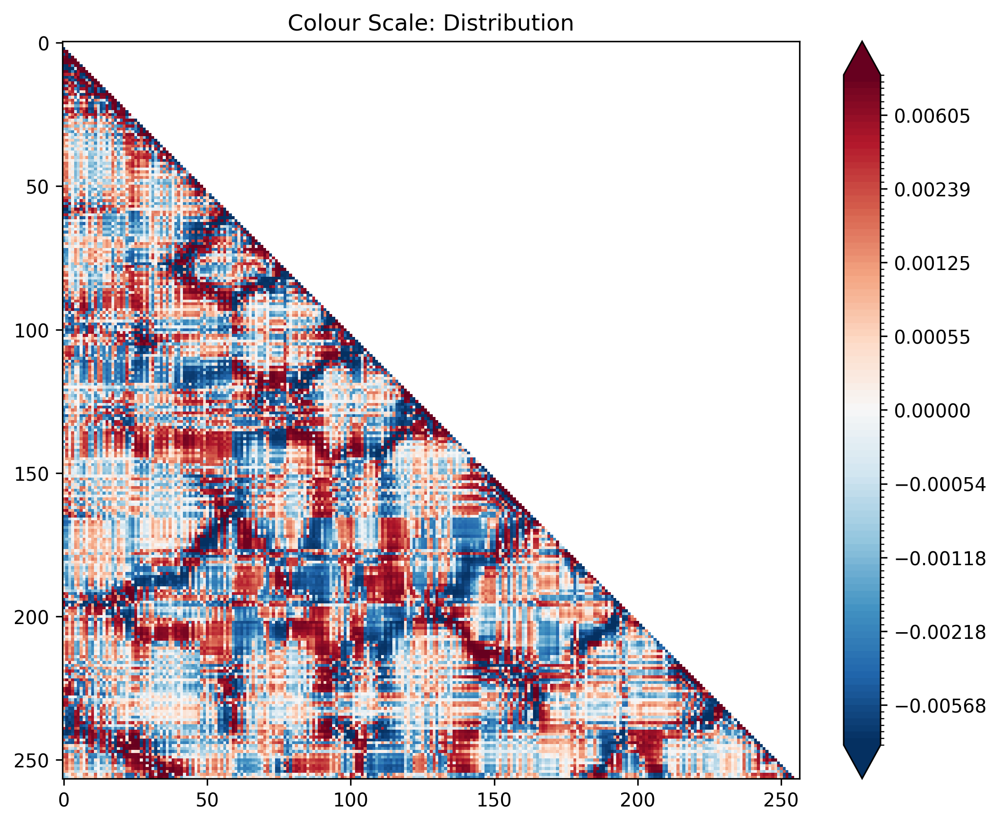

In [20]:
# oversampled 4x - resolution roughly equiv to original protein
step = 4
heatmap_non_linear_color(S=writhe_dict[step][0], x=writhe_dict[step][1])

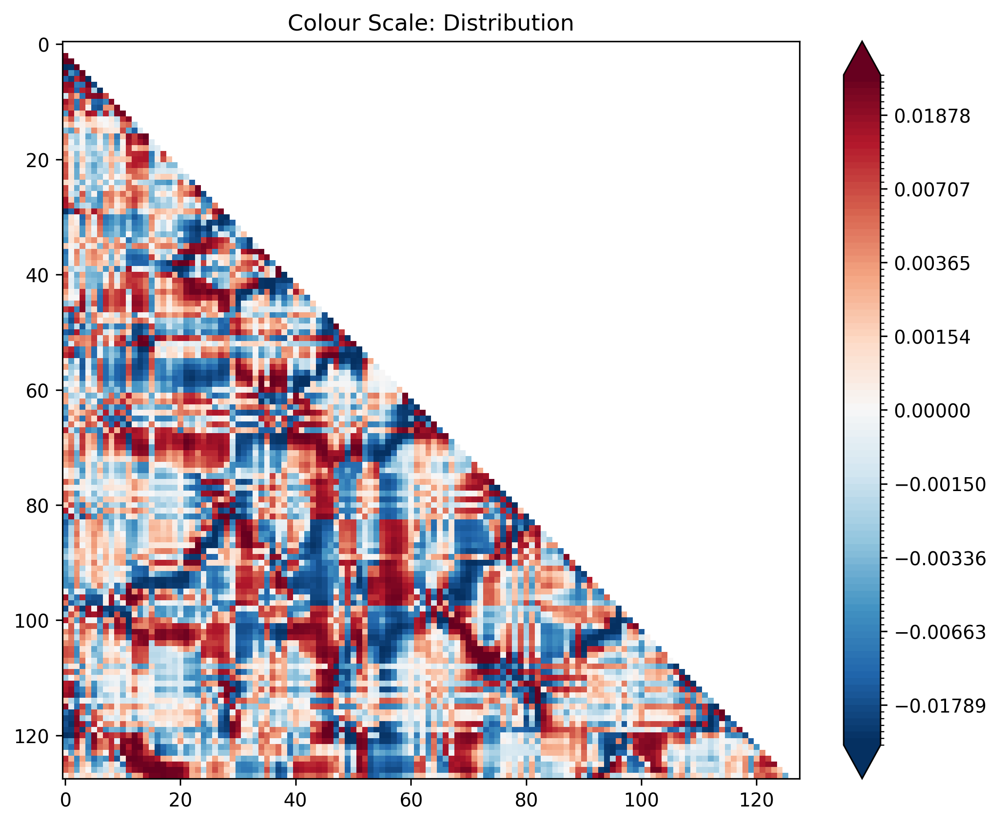

In [21]:
# oversampled 4x - resolution roughly equiv to every 2 atoms in protein
step = 8
heatmap_non_linear_color(S=writhe_dict[step][0], x=writhe_dict[step][1])

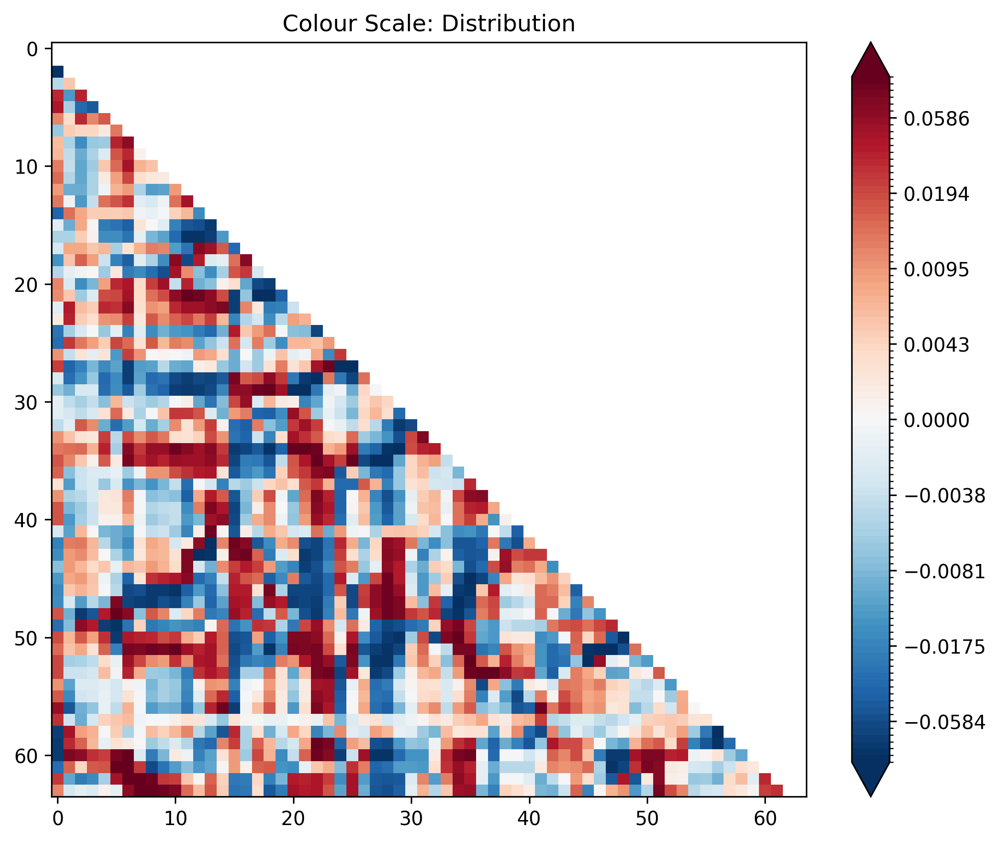

In [22]:
# oversampled 4x - resolution roughly equiv to every 4 atoms in protein
step = 16
heatmap_non_linear_color(S=writhe_dict[step][0], x=writhe_dict[step][1])

In [23]:
# step = 32
# fig = cdt.line_plotly(smooth_coords[::step,0], smooth_coords[::step,1], smooth_coords[::step,2], color_lst=len(x)*['blue'], outline=True)
# fig.update_layout(height = 800, width=800)

In [37]:
# writhe_dict = {}

# step_lst = [1,2,4,8,16]
# for step in step_lst:

#     writhe_dict[step] = give_me_writhe(coords[::step,:])

#     print('*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-* Step size: ' + str(step) + ' *-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*')
#     explore_pairwise_writhe(writhe_dict[step][0], writhe_dict[step][1])
#     print('')

### Visualising pairwise writhe for a given protein file - function

In [24]:
def pdb_to_Writhe(pdb_file):

    coords = cdt.extract_coords_from_PDB(pdb_file)
    S_, x_ = give_me_writhe(coords)
    heatmap_non_linear_color(S=S_, x=x_)

def coords_to_Writhe(coords):
    S_, x_ = give_me_writhe(coords)
    heatmap_non_linear_color(S=S_, x=x_)

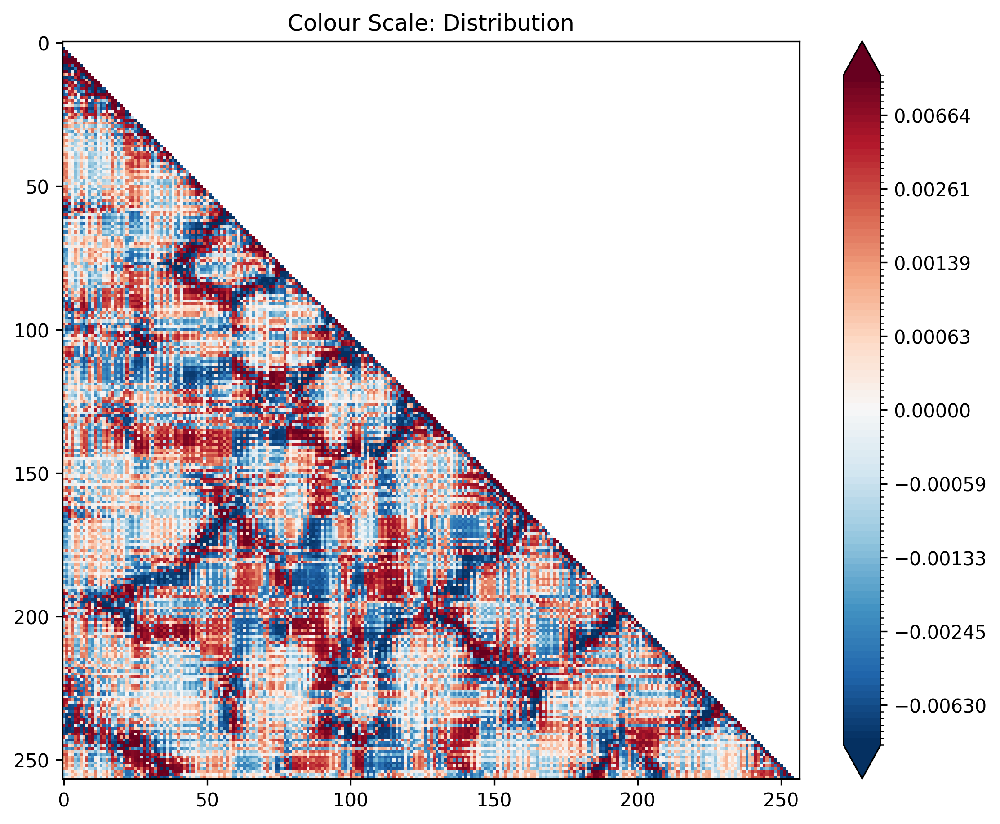

In [25]:
pdb_to_Writhe(pdb_file = '6zr9_A_Knot3_1.pdb')

### Well those are looking good eh? Now let see what happens when the segments are of random lengths

In [26]:
def random_sample_coords(coords, ls, us):

    rand_sample_coords = coords[0,:]
    
    stop=False
    ind = 0
    
    while stop==False:
    
        rand_step = np.random.randint(ls,us)
        ind += rand_step
        
        if ind < coords.shape[0]:
            rand_sample_coords = np.vstack([rand_sample_coords, coords[ind,:]])
    
        else:
            stop = True
    
            if sum(rand_sample_coords[-1, :] == coords[-1,:]) != 3:
                rand_sample_coords = np.vstack([rand_sample_coords, coords[-1,:]])

    return rand_sample_coords
        

In [27]:
def compare_protein_to_sample(x_lsts, y_lsts, z_lsts, color_lst, outline=None):

    '''
    Given lists of xs, ys and zs will plot them on top of each other
    Want to plot the original protein then whatever other representations we want
    ie. smoothed or sampled versions of the curve
    '''
    
    fig = go.Figure()

    for i in range(len(x_lsts)):
        
        if outline:
            if outline[i]:
                fig.add_trace(go.Scatter3d(x=x_lsts[i], y=y_lsts[i], z=z_lsts[i],
                                        mode='lines',
                                        line=dict( width=21, color='black')))

        fig.add_trace(go.Scatter3d(x=x_lsts[i], y=y_lsts[i], z=z_lsts[i],
                                   mode='lines',
                                   line=dict( width=12, color=color_lst[i])))

    fig['layout']['showlegend'] = False
    fig.update_layout( scene=dict(
        xaxis_title='',
        yaxis_title='',
        zaxis_title='',
        aspectratio = dict( x=1, y=1, z=1 ),
        aspectmode = 'manual',
        xaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),
        yaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),
        zaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),),
        )

    fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))
    fig.update_traces(showlegend=False)
    return fig

In [28]:
rand_sample_coords = random_sample_coords(coords, 1, 8)

# make lists for xs, ys, zs  [ [protein x], [sampled x], [ect ..] ]

# [ protein, random sample ]
x_lsts = [ coords[:,0], rand_sample_coords[:,0] ] 
y_lsts = [ coords[:,1], rand_sample_coords[:,1] ] 
z_lsts = [ coords[:,2], rand_sample_coords[:,2] ] 

color_lst = ['black', 'orange']

In [29]:
fig = compare_protein_to_sample(x_lsts, y_lsts, z_lsts, color_lst, outline=[False, True])
fig.update_layout(height = 800, width=800)

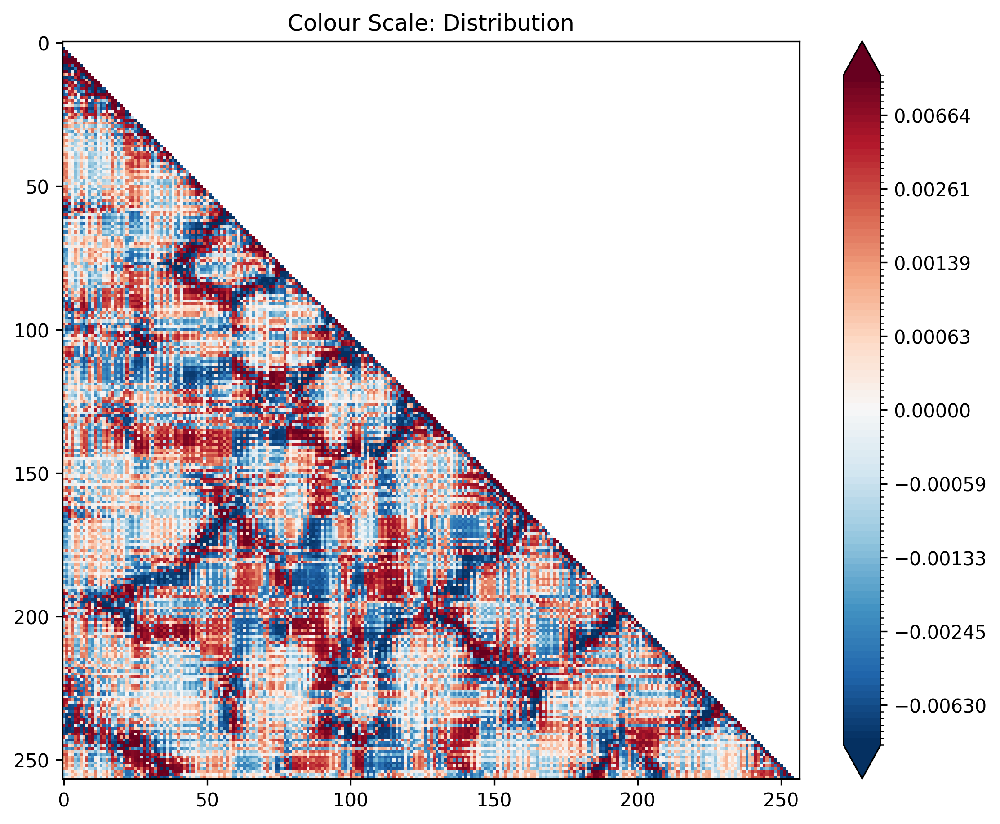

In [30]:
# see the writhe space of the full protein
coords_to_Writhe(coords)

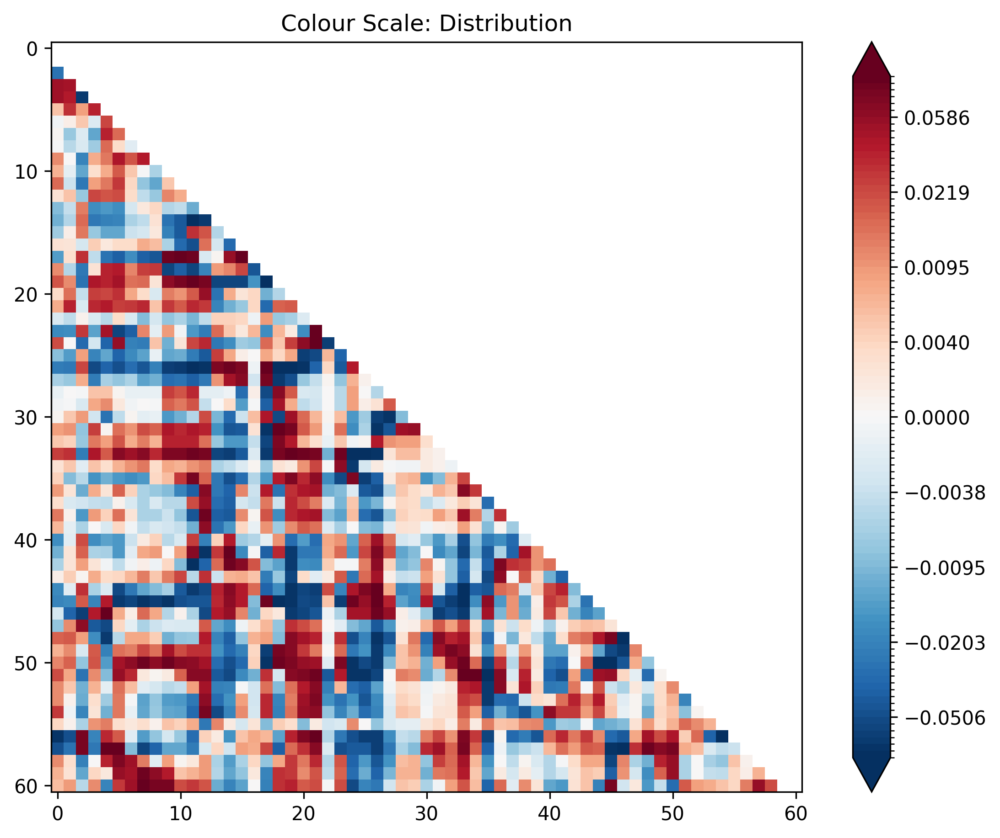

In [31]:
# random sample (ie each segment length is between 1-8)
coords_to_Writhe(rand_sample_coords)

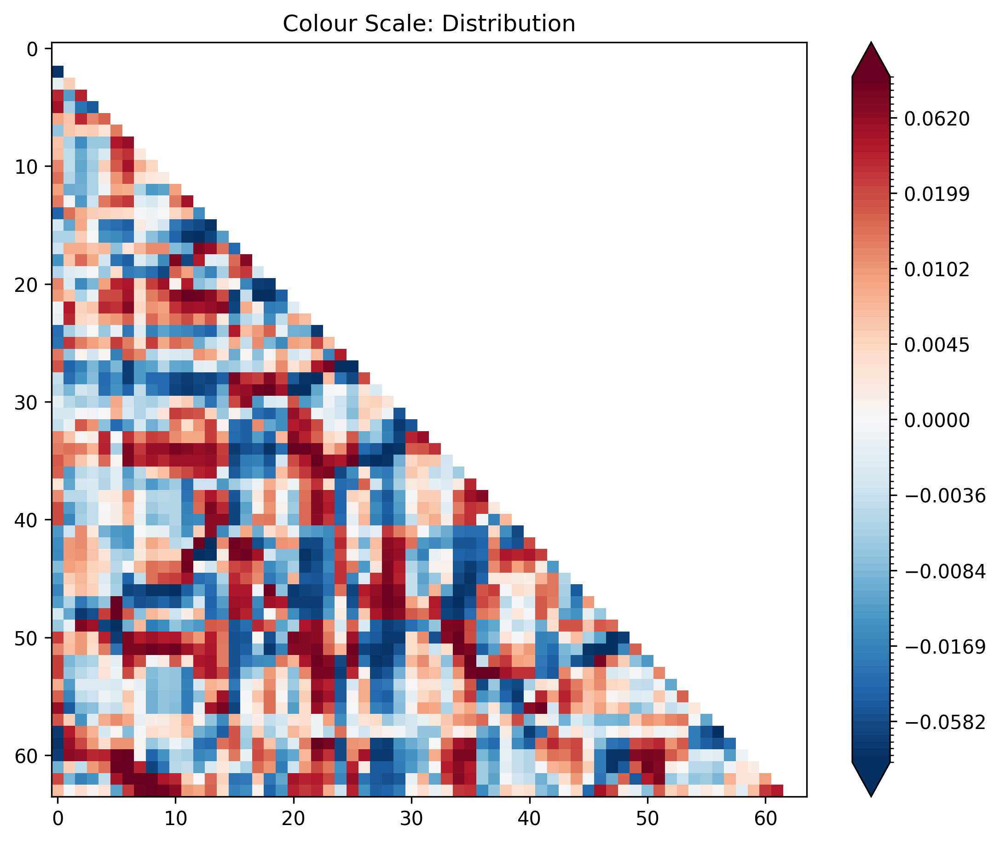

In [32]:
# The protein sampled every 4 atoms
coords_to_Writhe(coords[::4])

In [33]:
# [ protein, random sample ]
x_lsts = [ coords[:,0], coords[::4,0] ] 
y_lsts = [ coords[:,1], coords[::4,1] ] 
z_lsts = [ coords[:,2], coords[::4,2] ] 

color_lst = ['black', 'orange']

fig = compare_protein_to_sample(x_lsts, y_lsts, z_lsts, color_lst, outline=[False, True])
fig.update_layout(height = 800, width=800)

### Arron sampling code (stolen - sorry Arron)

In [34]:
def data_for_cylinder_along_arb(center,tandirec,height_z,radius=0.6):
    if np.abs(1.0-tandirec[2])>0.0001:
        z = np.linspace(0, height_z, int(height_z))  
        theta = np.linspace(0, 2*np.pi,25)
        theta_grid, z_grid=np.meshgrid(theta, z)
        tperp = np.sqrt(tandirec[0]*tandirec[0] + tandirec[1]*tandirec[1])
        x_grid = (radius/tperp)*(tandirec[1]*np.cos(theta_grid) + tandirec[0]*tandirec[2]*np.sin(theta_grid))  + tandirec[0]*z_grid + center[0]
        y_grid = (radius/tperp)*(-tandirec[0]*np.cos(theta_grid)+ tandirec[1]*tandirec[2]*np.sin(theta_grid)) + tandirec[1]*z_grid + center[1]
        z_grid = radius*(tandirec[2]**2-1)*np.sin(theta_grid)/tperp+ tandirec[2]*z_grid + center[2]
    else:
        z = np.linspace(0, height_z, int(height_z))  
        theta = np.linspace(0, 2*np.pi,25)
        theta_grid, z_grid=np.meshgrid(theta, z)
        x_grid = radius*np.cos(theta_grid) + center[0]
        y_grid = radius*np.sin(theta_grid) + center[1]
        z_grid = tandirec[2]*z_grid + center[2]
       
    return x_grid,y_grid,z_grid


def plot_molecule_tube(mol):
    # file_loc = 'data/CleanedSKMT/'+pdb_code+'.xyz'
    times = 25
    # mol = np.genfromtxt(file_loc)

    Xc,Yc,Zc = data_for_cylinder_along_arb(mol[0],(mol[1]-mol[0])/np.linalg.norm(mol[1]-mol[0]),np.linalg.norm(mol[1]-mol[0]))
    for i in range(2,len(mol)):
        normalised_tangent =  (mol[i]-mol[i-1])/np.linalg.norm(mol[i]-mol[i-1])
        prev_normalised_tangent = (mol[i-1]-mol[i-2])/np.linalg.norm(mol[i-1]-mol[i-2])
        for j in range(1,times):
            cap_data = data_for_cylinder_along_arb(mol[i-1],
                                                   ((times-j)/(times-1))*prev_normalised_tangent + (j/(times-1))*normalised_tangent,
                                                   1,
                                                  )
            Xc = np.concatenate((Xc,cap_data[0]),axis=0)
            Yc = np.concatenate((Yc,cap_data[1]),axis=0)
            Zc = np.concatenate((Zc,cap_data[2]),axis=0)
        edge_data = data_for_cylinder_along_arb(mol[i-1],
                                                normalised_tangent,
                                                int(np.linalg.norm(mol[i]-mol[i-1]))
                                               )
        Xc = np.concatenate((Xc,edge_data[0]),axis=0)
        Yc = np.concatenate((Yc,edge_data[1]),axis=0)
        Zc = np.concatenate((Zc,edge_data[2]),axis=0)

    surcol = np.zeros((Zc-Zc[0]).shape)
    for i in range(len(surcol)):
        surcol[i] = i*np.ones(surcol[i].shape)
    lighting_effects = dict(ambient=0.5, diffuse=0.25, roughness = 0.9, specular=0.65, fresnel=1)
    fig = go.Figure()
    fig.add_trace(go.Surface(x=Xc, y=Yc, z=Zc,
                             showscale=False,
                             surfacecolor=surcol,
                             colorscale='Rainbow',
                             lighting=dict(lighting_effects),
                             lightposition=dict(x=1000,y=1000,z=1000),
                             hoverinfo='none'
                            )
                 )
    colorbar_trace = go.Scatter3d(x=[None],
                                  y=[None],
                                  z=[None],
                                  mode='markers',
                                  marker=dict(
                                      colorscale='Rainbow',
                                      showscale=True,
                                      cmin=surcol[0][0],
                                      cmax=surcol[-1][0],
                                      colorbar=dict(thickness=25, 
                                                    tickvals=[surcol[0][0],surcol[-1][0]], 
                                                    ticktext=['Start','End'],
                                                    outlinewidth=0)
                                  ),
                                  hoverinfo='none'
                                 )
    fig.add_trace(colorbar_trace)
    fig.update_layout(width=1000,height=1000)
    fig.update_layout(
    scene=dict(
        xaxis_title='',
        yaxis_title='',
        zaxis_title='',
        aspectratio = dict( x=1, y=1, z=1 ),
        aspectmode = 'manual',
        xaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),
        yaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),
        zaxis = dict(
            gridcolor="white",
            showbackground=False,
            zerolinecolor="white",
            nticks=0,
            showticklabels=False),),
    )
    fig.show()

In [35]:
# plot_molecule_tube(coords)